In [2]:
import matplotlib.pyplot as plt
import networkx as nx
import numpy as np
from collections import defaultdict
import collections
import argparse
import ast
import sys
import gzip
import csv
import pprint
import pandas as pd
import neet.sensitivity as ns
import neet.boolean as nn
from neet.boolean.examples import c_elegans
from itertools import groupby
from mpl_toolkits.axes_grid1 import make_axes_locatable
import datetime as dt

from scipy import stats
import scipy as sp
import community
from scipy.spatial.distance import pdist, squareform
from sklearn import datasets
from matplotlib import patches

from network_ei import *
from causal_emergence import *
from get_motifs import *

import matplotlib.patches as mpatches
from matplotlib import gridspec
from matplotlib._png import read_png
from matplotlib.offsetbox import AnnotationBbox, OffsetImage
plt.rc('axes', axisbelow=True)
%matplotlib inline

In [3]:
def unbalanced_barbell(n_left, n_right=100, n_connectors=1, p0=0):
    """
    Creates a barbell with n_left=some number less than n_right, connected by n_connectors
    """
    G1 = nx.complete_graph(n_left)
    for i in range(n_right):
        G1.add_node(i+n_left)
    for eij in range(n_connectors):
        G1.add_edge(eij, n_left+eij)
    for i in range(n_left, n_left+n_right):
        for j in range(n_left, n_left+n_right):
            if i!=j:
                G1.add_edge(i,j)
    G = prepare_network(G1, p0)
    
    return G

# Random Clustered Networks

In [4]:
def get_chunksize_dict(N, size_dist):
    """Returns an array of size_dist-distributed chunks for your network"""
    chunksize_dist = np.array(size_dist)
    chunksize_dist = sorted(chunksize_dist, reverse=True)
    chunksizes = np.array(N*(chunksize_dist/sum(chunksize_dist)), dtype=int)
    diff_size_check = int(N - sum(chunksizes))
    if diff_size_check > 0:
        for i in range(diff_size_check):
            chunksizes[0] += 1
    if diff_size_check < 0:
        for i in range(np.abs(diff_size_check)):
            chunksizes[0] -= 1

    for i in range(len(chunksizes)):
        if chunksizes[i] == 0:
            chunksizes[0] -= 2
            chunksizes[i] += 2

        if chunksizes[i] == 1:
            chunksizes[0] -= 1
            chunksizes[i] += 1    

    chunk_dict = {}
    curr = 0
    for i in range(len(chunksizes)):
        nums = list(range(curr, curr+chunksizes[i]))
        chunk_dict[i] = nums
        curr = nums[-1]+1
    
    node_chunks_dict = {}
    for k in chunk_dict.keys():
        for i in chunk_dict[k]:
            node_chunks_dict[i] = k
    
    return chunk_dict, node_chunks_dict

def random_clustered_network(N, p, q, chunksize_dist, ret_data=False):
    """
    Creates n_chunk groups of chunksize_dist number of nodes, 
    connecting internally with p and externally with q
    """
    chunksize_dist = size_dist
    chunksize_dist = sorted(chunksize_dist, reverse=True)
    chunksizes = np.array(N*(chunksize_dist/sum(chunksize_dist)), dtype=int)
    diff_size_check = int(N - sum(chunksizes))
    if diff_size_check > 0:
        for i in range(diff_size_check):
            chunksizes[0] += 1
    if diff_size_check < 0:
        for i in range(np.abs(diff_size_check)):
            chunksizes[0] -= 1
    
    for i in range(len(chunksizes)):
        if chunksizes[i] == 0:
            chunksizes[0] -= 2
            chunksizes[i] += 2
    
        if chunksizes[i] == 1:
            chunksizes[0] -= 1
            chunksizes[i] += 1
            
    condition = True
    
    while condition:
        macro_labels = []
        G = nx.Graph()
        q_edge = 0
        p_edge = 0
        
        for chunk in range(len(chunksizes)):
            N_current = G.number_of_nodes()
            old_chunknodes = list(G.nodes())
            new_chunknodes = [i+N_current for i in range(chunksizes[chunk])]
            newG = nx.path_graph(len(new_chunknodes))
            newG = nx.relabel_nodes(newG, dict(zip(newG.nodes(), new_chunknodes)))
            G.add_nodes_from(new_chunknodes)
            G.add_edges_from(newG.edges())
            p_edge += newG.number_of_edges()
            if old_chunknodes:
                G.add_edge(new_chunknodes[0], old_chunknodes[-1])
                q_edge += 1
                
            for node_i in new_chunknodes:
                macro_labels.append(chunk)
                for node_j in new_chunknodes:
                    if node_i != node_j and (node_i, node_j) not in G.edges() and \
                    (node_j, node_i) not in G.edges() and np.random.rand() < p:
                        p_edge += 1
                        G.add_edge(node_i, node_j)

                for node_k in old_chunknodes:
                    if node_i != node_k and (node_i, node_k) not in G.edges() and \
                    (node_k, node_i) not in G.edges() and np.random.rand() < q:
                        q_edge += 1
                        G.add_edge(node_i, node_k)
                            
        if nx.is_connected(G):
            condition=False
    
    nx.set_node_attributes(G, dict(zip(G.nodes(),macro_labels)), name='macro')
    if ret_data:
        return G, {'p_edges':p_edge, 'q_edges':q_edge, 'p_frac':p_edge/(p_edge+q_edge)}
    else:
        return G
    
def random_clustered_network_m(N, p, q, size_dist, m=1):
    """
    Creates n_chunk groups of chunksize_dist number of nodes, 
    connecting internally with p and externally with q
    """
    G = nx.Graph()
    all_nodes = list(range(N))
    G.add_nodes_from(all_nodes)

    chunk_dict, node_chunk_dict = get_chunksize_dict(N, size_dist)
    while min([len(chunk) for chunk in chunk_dict.values()]) <= m:
        size_dist = size_dist + softmax(size_dist)
        chunk_dict, node_chunk_dict = get_chunksize_dict(N, size_dist)

    for node_i, chunk_k in node_chunk_dict.items():
        # no self-loops
        prob_dict = {node_i:0}

        chunknodes_inside = list(set(chunk_dict[chunk_k])-set([node_i]))
        chunknodes_outside = list(set(all_nodes)-set(chunk_dict[chunk_k]))
        for ins in chunknodes_inside:
            prob_dict[ins] = p / len(chunknodes_inside)
        for out in chunknodes_outside:
            prob_dict[out] = q / len(chunknodes_outside)

        prob_dict = dict(collections.OrderedDict(sorted(prob_dict.items())))
        probs = np.array(list(prob_dict.values()))
        eijs = np.random.multinomial(m, probs, 1)[0]
        e = np.nonzero(eijs)[0]
        neighbors = G.neighbors(node_i)
        
        while max(eijs) > 1 or max(eijs) < 1 or len([i for i in e if i in neighbors]) > 0:
            eijs = np.random.multinomial(m, probs, 1)[0]
            e = np.nonzero(eijs)[0]

        for node_j in e:
            G.add_edge(node_i, node_j)
            G.add_edge(node_j, node_i)

    nx.set_node_attributes(G, node_chunk_dict, name='macro')
    return G

In [5]:
def get_pos(N, size_dist):
    """Arranges the graphs nicely"""
    pos = {}
    chunk_dict, node_chunk_dict = get_chunksize_dict(N, size_dist)
    ii = 0
#     for chunk, nodes in chunk_dict.items():
    for chunk, nodes in sorted(chunk_dict.items(), key=lambda kv: kv[1][0], reverse=True):
        frac_nodes = N/len(nodes)
        G = nx.complete_graph(len(nodes))
        posi = nx.spring_layout(G)
        posi = dict(zip(nodes, (np.array(list(posi.values()))/frac_nodes + np.array([1.5*ii,0]))))
        pos.update(posi)
        ii += 1
                
    return pos

In [6]:
def get_macro(G, macro_mapping, p0=0):
    """
    Given an input graph and a micro-to-macro mapping, output a macro transition matrix.
    - param G: current micro graph
    - param macro_mapping: a dictionary with {micro_node:macro_node}
    - param p0: smallest probability
    
    - output: Macro, a macro-level transition-probability matrix
    """
    # might have to assert node_labels to be integers
    G = prepare_network(G,p0=p0)
    micro_network_size = G.number_of_nodes()
    micro_Wout = get_Wout_full(G, p0)
    micro_nodes = np.unique(list(macro_mapping.keys()))
    nodes_in_macro_network = np.unique(list(macro_mapping.values()))

    macro_network_size = len(nodes_in_macro_network)
    macro_nodes = nodes_in_macro_network[nodes_in_macro_network > micro_network_size-1]
    n_macro = len(macro_nodes)
    
    if n_macro==0:
        return micro_Wout
    
    micro_to_macro_list = []
    for macro_i in range(n_macro):
        micro_in_macro_i = [k for k,v in macro_mapping.items() if v==macro_nodes[macro_i]]
        micro_to_macro_list.append(micro_in_macro_i)
    
    # get new rows
    macro_row_list = []
    for macro_i in micro_to_macro_list:
        macro_row_list.append(sum(micro_Wout[macro_i,:]))
    
    macro_rows = np.vstack(macro_row_list)

    # get new cols
    macro_col_list = []
    for macro_i in micro_to_macro_list:
        macro_col_list.append(sum(micro_Wout.T[macro_i,:]))

    macro_cols = np.vstack(macro_col_list)    
    macro_cols = macro_cols.T
    
    # get stubby diagonal square in the bottom right
    macro_bottom_right = np.zeros((n_macro,n_macro))
    for macro_i in range(n_macro):
        for macro_j in range(n_macro):
            macro_bottom_right[macro_i, macro_j] = sum(macro_row_list[macro_i][micro_to_macro_list[macro_j]])

    # put them all together in a matrix that is too big
    too_big_macro = np.block([[micro_Wout, macro_cols], [macro_rows, macro_bottom_right]])
    
    macro_out = too_big_macro[nodes_in_macro_network,:][:,nodes_in_macro_network]
    
    Macro = macro_out / macro_out.sum(axis=1)[:, np.newaxis]
    
    return Macro


In [7]:
def get_macro(G, macro_mapping, p0=0):
    """
    Given an input graph and a micro-to-macro mapping, output a macro transition matrix.
    - param G: current micro graph
    - param macro_mapping: a dictionary with {micro_node:macro_node}
    - param p0: smallest probability
    
    - output: Macro, a macro-level transition-probability matrix
    """
    # might have to assert node_labels to be integers
    G = prepare_network(G,p0=p0)
    micro_network_size = G.number_of_nodes()
    micro_Wout = get_Wout_full(G, p0)
    micro_nodes = np.unique(list(macro_mapping.keys()))
    nodes_in_macro_network = np.unique(list(macro_mapping.values()))

    macro_network_size = len(nodes_in_macro_network)
    macro_nodes = nodes_in_macro_network[nodes_in_macro_network > micro_network_size-1]
    n_macro = len(macro_nodes)
    
    if n_macro==0:
        return micro_Wout
    
    micro_to_macro_list = []
    for macro_i in range(n_macro):
        micro_in_macro_i = [k for k,v in macro_mapping.items() if v==macro_nodes[macro_i]]
        micro_to_macro_list.append(micro_in_macro_i)
    
    # get new rows
    macro_row_list = []
    for macro_i in micro_to_macro_list:
        macro_row_list.append(sum(micro_Wout[macro_i,:]))
    
    macro_rows = np.vstack(macro_row_list)

    # get new cols
    macro_col_list = []
    for macro_i in micro_to_macro_list:
        macro_col_list.append(sum(micro_Wout.T[macro_i,:]))

    macro_cols = np.vstack(macro_col_list)    
    macro_cols = macro_cols.T
    
    # get stubby diagonal square in the bottom right
    macro_bottom_right = np.zeros((n_macro,n_macro))
    for macro_i in range(n_macro):
        for macro_j in range(n_macro):
            macro_bottom_right[macro_i, macro_j] = sum(macro_row_list[macro_i][micro_to_macro_list[macro_j]])

    # put them all together in a matrix that is too big
    too_big_macro = np.block([[micro_Wout, macro_cols], [macro_rows, macro_bottom_right]])
    
    macro_out = too_big_macro[nodes_in_macro_network,:][:,nodes_in_macro_network]
    
    Macro = macro_out / macro_out.sum(axis=1)[:, np.newaxis]
    
    return Macro

def causal_emergence(G, p0=0, thresh=0.0001, printt=True, ntimes=-1):
    """
    Given a micro-scale network, iterate through possible macro-groupings and look for causal emergence.
    - param G: a networkx object or adjacency matrix or TPM
    - param p0: smallest probability
    
    - output Gm: a macro-scale network object with higher EI than G
    """
    G = prepare_network(G, p0)
    current_ei = get_ei(G, p0)
    micro_nodes_left = list(G.nodes())
    micros_that_have_been_macroed = []
    macro_mapping = dict(zip(micro_nodes_left, micro_nodes_left))    
    if printt:
        print("Starting with this tpm:\n",np.round(get_Wout_full(G,p0), 4))
        print("\nSearch started... current_ei = %.4f"%current_ei)
    EI_G = current_ei
    change_in_ei_dict_max = {}
    change_in_ei_dict_mean = {}
    
    count = 0
    np.random.shuffle(micro_nodes_left)

    ##############
    if ntimes != -1 and ntimes < len(micro_nodes_left):
        micro_nodes_left = micro_nodes_left[:ntimes]
    ##############

    for node_i in micro_nodes_left:
        change_in_ei_dict = []
        
        count += 1
        if printt:
            print("%03i"%count, "...",node_i,"...","macro size =",len(np.unique(list(macro_mapping.values()))))

        neighbors_i = set(list(G.successors(node_i))).union(set(list(G.predecessors(node_i))))
        for node_j in neighbors_i:
            neighbors_j = set(list(G.successors(node_j))).union(set(list(G.predecessors(node_j))))
            neighbors_i = neighbors_j.union(neighbors_i)
        macros_to_check = [i for i in list(neighbors_i) if i!=node_i]
        queue = macros_to_check.copy()

        node_i_macro = macro_mapping[node_i]
        if node_i_macro == node_i:
            node_i_macro = max(list(macro_mapping.values()))+1
            
        while len(queue) > 0:
            np.random.shuffle(queue)
            possible_macro = queue.pop()

            possible_mapping = macro_mapping.copy()
            possible_mapping[node_i]         = node_i_macro
            possible_mapping[possible_macro] = node_i_macro

            try:
                MACRO = get_macro(G, possible_mapping, p0)
                macro_ei = get_ei(MACRO, p0)
                Gm = prepare_network(MACRO, p0=p0)
            except:
                continue

            MACRO = get_macro(G, possible_mapping, p0)
            macro_ei = get_ei(MACRO, p0)
            Gm = prepare_network(MACRO, p0=p0)
            
            change_in_ei_dict.append(macro_ei - EI_G)
    
            if macro_ei - current_ei > thresh:
                current_ei = macro_ei
                macro_mapping = possible_mapping
                if printt:
                    print("just found successful macro grouping... current_ei = %.4f"%current_ei)
                micros_that_have_been_macroed.append(node_i)
                micros_that_have_been_macroed.append(possible_macro)
                micros_that_have_been_macroed = list(set(micros_that_have_been_macroed))

                nodes_in_macro_i = [k for k, v in macro_mapping.items() if v==node_i_macro]
                
                for new_micro_in_macro_i in nodes_in_macro_i:
                    neighbors_Mi = set(list(
                        G.successors(new_micro_in_macro_i))).\
                        union(set(list(G.predecessors(new_micro_in_macro_i))))
                        
                    for node_Mj in neighbors_Mi:
                        if node_Mj not in queue and node_Mj != node_i:
                            queue.append(node_Mj)

        if change_in_ei_dict:
            change_in_ei_dict_mean[node_i] = np.mean(change_in_ei_dict)
            change_in_ei_dict_max[ node_i] =     max(change_in_ei_dict)
    
    nx.set_node_attributes(G, change_in_ei_dict_mean, 'mean_EI_change')
    nx.set_node_attributes(G, change_in_ei_dict_max,  'max_EI_change')
    nx.set_node_attributes(G, dict(zip(micro_nodes_left,G.nodes())), 'order')
    try:
        MACRO = get_macro(G, macro_mapping, p0)
        Gm = prepare_network(MACRO, p0=p0)
        return Gm, macro_mapping, G
    except:
        return [], macro_mapping, G    

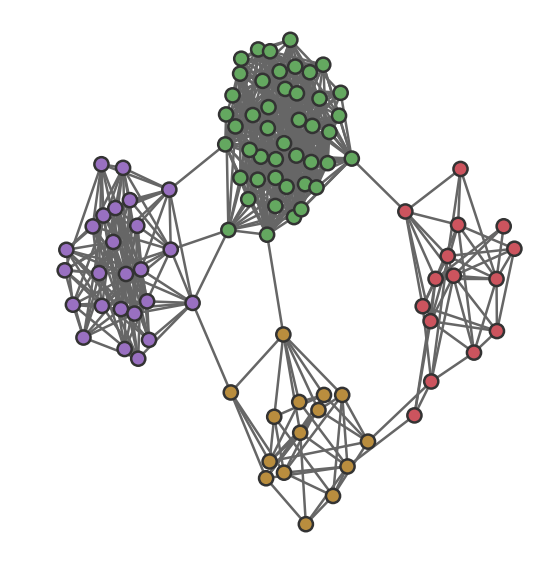

In [13]:
size_dist = np.array([3.0, 2.0, 2.5, 2.0])
ncomms = 4
N = 100; p=0.2; q=0.002
size_dist = softmax(size_dist)
G = random_clustered_network(N, p, q, size_dist)
# G = nx.barabasi_albert_graph(N, 1)

colors = ["#64a860", "#9970c1", "#b98d3e", "#cc545e"]
nodecols = [colors[i] for i in nx.get_node_attributes(G,'macro').values()]

plt.figure(figsize=(9,10))
pos = nx.kamada_kawai_layout(G)
nx.draw_networkx_nodes(G, pos, node_size=200, 
                       linewidths=2.5, node_color=nodecols).set_edgecolor('#333333')
nx.draw_networkx_edges(G, pos, edge_color='#666666', width=2.5)
plt.axis('off')

# plt.savefig("../figs/pngs/ClusteredNetwork.png", dpi=425, bbox_inches='tight')
plt.show()

In [9]:
p0=0

In [10]:
printt=True

In [11]:
ntimes = -1
thresh=0.0001

In [12]:
# G = prepare_network(G, p0)
# current_ei = get_ei(G, p0)
# micro_nodes_left = list(G.nodes())
# micros_that_have_been_macroed = []
# macro_mapping = dict(zip(micro_nodes_left, micro_nodes_left))    
# if printt:
#     print("Starting with this tpm:\n",np.round(get_Wout_full(G,p0), 4))
#     print("\nSearch started... current_ei = %.4f"%current_ei)
# EI_G = current_ei
# change_in_ei_dict_max = {}
# change_in_ei_dict_mean = {}
# running_ei = [current_ei]
# count = 0
# np.random.shuffle(micro_nodes_left)
# pos = nx.kamada_kawai_layout(G)
# ##############
# if ntimes != -1 and ntimes < len(micro_nodes_left):
#     micro_nodes_left = micro_nodes_left[:ntimes]
# ##############
# xval = 1
# xvals = [xval]
# for node_i in micro_nodes_left:
#     change_in_ei_dict = []

#     count += 1
#     if printt:
#         print("%03i"%count, "...",node_i,"...","macro size =",len(np.unique(list(macro_mapping.values()))))

#     neighbors_i = set(list(G.successors(node_i))).union(set(list(G.predecessors(node_i))))
#     for node_j in neighbors_i:
#         neighbors_j = set(list(G.successors(node_j))).union(set(list(G.predecessors(node_j))))
#         neighbors_i = neighbors_j.union(neighbors_i)
#     macros_to_check = [i for i in list(neighbors_i) if i!=node_i]
#     queue = macros_to_check.copy()

#     node_i_macro = macro_mapping[node_i]
#     if node_i_macro == node_i:
#         node_i_macro = max(list(macro_mapping.values()))+1

#     while len(queue) > 0:
#         np.random.shuffle(queue)
#         possible_macro = queue.pop()

#         possible_mapping = macro_mapping.copy()
#         possible_mapping[node_i]         = node_i_macro
#         possible_mapping[possible_macro] = node_i_macro

#         try:
#             MACRO = get_macro(G, possible_mapping, p0)
#             macro_ei = get_ei(MACRO, p0)
#             Gm = prepare_network(MACRO, p0=p0)
#         except:
#             continue

#         MACRO = get_macro(G, possible_mapping, p0)
#         macro_ei = get_ei(MACRO, p0)
#         Gm = prepare_network(MACRO, p0=p0)

#         change_in_ei_dict.append(macro_ei - EI_G)
        
#         Gplot = nx.Graph(Gm)
        
#         fig, (ax0, ax1) = plt.subplots(1, 2, figsize=(16,8))
        
#         pos = nx.kamada_kawai_layout(Gplot)
#         ax0.plot(xvals, running_ei)
        
#         ax0.grid(True, linestyle='--', linewidth=3.0, alpha=0.5)
#         ax0.set_xlabel("Iteration", size=22)
#         ax0.set_ylabel(r"$EI$", size=24)
#         xticks = np.linspace(0, G.number_of_nodes(), 5)
#         ax0.set_xticks(xticks)
#         ax0.set_xticklabels(["%i"%i for i in xticks], fontsize=16)
#         yticks = np.linspace(0, 10, 5)
#         ax0.set_yticks(yticks)
#         ax0.set_yticklabels(["%.1f"%i for i in yticks], fontsize=16)
#         ax0.set_xlim(-1,G.number_of_nodes()+1)
#         ax0.set_ylim(-0.1, 10.1)

#         # pos = nx.kamada_kawai_layout(G)
#         nodelist = [possible_macro, node_i]
#         excolor = 'dodgerblue'
#         if macro_ei - EI_G > 0:
#             excolor = 'crimson'
#         nx.draw_networkx_nodes(Gplot, pos, node_size=200, 
#                                linewidths=2.5, node_color='w', ax=ax1).set_edgecolor('#333333')
#         nx.draw_networkx_nodes(Gplot, pos, nodelist=nodelist, node_size=200, 
#                                linewidths=2.5, node_color=excolor, ax=ax1).set_edgecolor('#333333')
#         nx.draw_networkx_edges(Gplot, pos, edge_color='grey', width=2.0, ax=ax1)
#         ax1.set_axis_off()

#         plt.savefig("../figs/pngs/ce_test_gif%04i_%i.png"%(count,possible_macro), dpi=225, bbox_inches='tight')
# #         plt.show()        
#         plt.close()
        
#         if macro_ei - current_ei > thresh:
#             current_ei = macro_ei
#             macro_mapping = possible_mapping
#             if printt:
#                 print("just found successful macro grouping... current_ei = %.4f"%current_ei)
#             micros_that_have_been_macroed.append(node_i)
#             micros_that_have_been_macroed.append(possible_macro)
#             micros_that_have_been_macroed = list(set(micros_that_have_been_macroed))

#             nodes_in_macro_i = [k for k, v in macro_mapping.items() if v==node_i_macro]

#             for new_micro_in_macro_i in nodes_in_macro_i:
#                 neighbors_Mi = set(list(
#                     G.successors(new_micro_in_macro_i))).\
#                     union(set(list(G.predecessors(new_micro_in_macro_i))))

#                 for node_Mj in neighbors_Mi:
#                     if node_Mj not in queue and node_Mj != node_i:
#                         queue.append(node_Mj)

#     running_ei.append(current_ei)
#     xval += 1
#     xvals.append(xval+1)
#     if change_in_ei_dict:
#         change_in_ei_dict_mean[node_i] = np.mean(change_in_ei_dict)
#         change_in_ei_dict_max[ node_i] =     max(change_in_ei_dict)

In [96]:
order_nodes = list(list(zip(*list(zip(nx.get_node_attributes(G, 'order').values(), 
                                      nx.get_node_attributes(G, 'order').keys()))))[0])

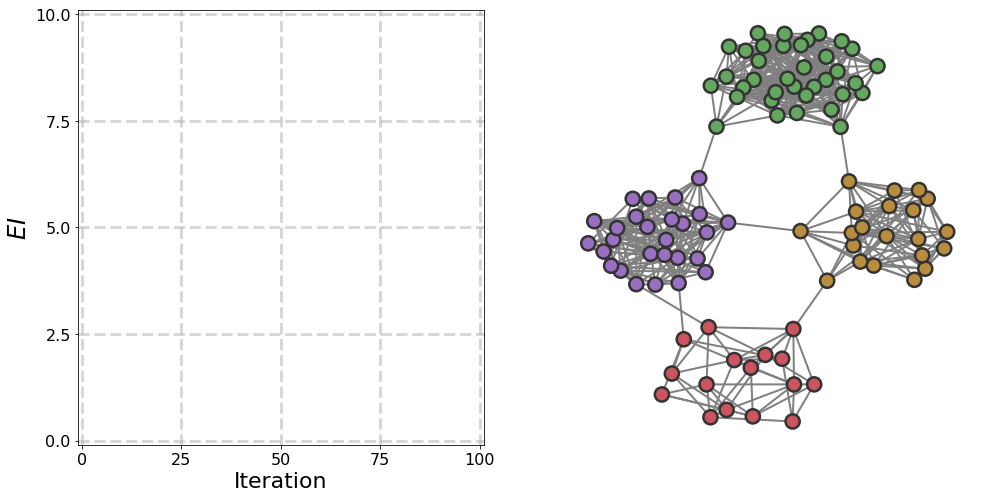

In [35]:
fig, (ax0, ax1) = plt.subplots(1, 2, figsize=(16,8))

ax0.grid(True, linestyle='--', linewidth=3.0, alpha=0.5)
ax0.set_xlabel("Iteration", size=22)
ax0.set_ylabel(r"$EI$", size=24)
xticks = np.linspace(0, G.number_of_nodes(), 5)
ax0.set_xticks(xticks)
ax0.set_xticklabels(["%i"%i for i in xticks], fontsize=16)
yticks = np.linspace(0, 10, 5)
ax0.set_yticks(yticks)
ax0.set_yticklabels(["%.1f"%i for i in yticks], fontsize=16)
ax0.set_xlim(-1,G.number_of_nodes()+1)
ax0.set_ylim(-0.1, 10.1)

# pos = nx.kamada_kawai_layout(G)
nx.draw_networkx_nodes(G, pos, node_size=200, 
                       linewidths=2.5, node_color=nodecols, ax=ax1).set_edgecolor('#333333')
nx.draw_networkx_edges(G, pos, edge_color='grey', width=2.0, ax=ax1)
ax1.set_axis_off()

plt.show()

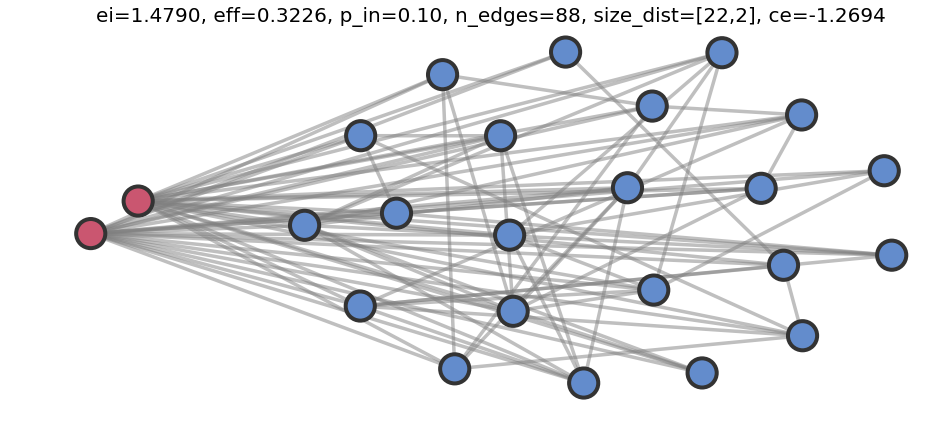

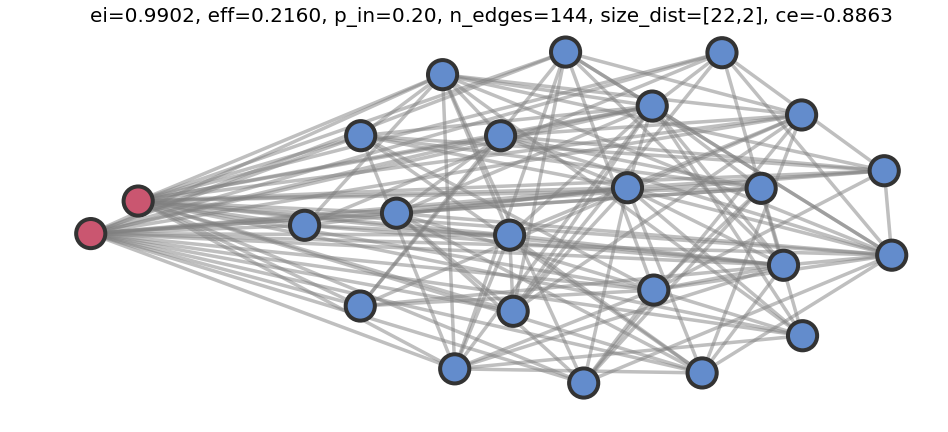

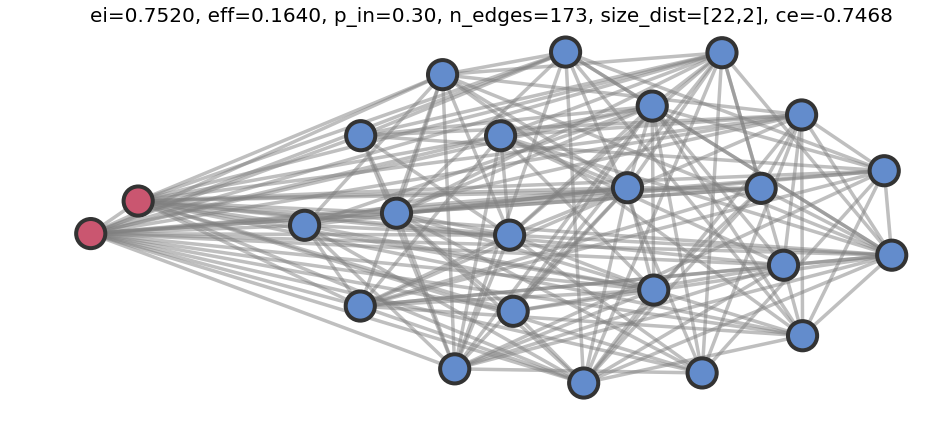

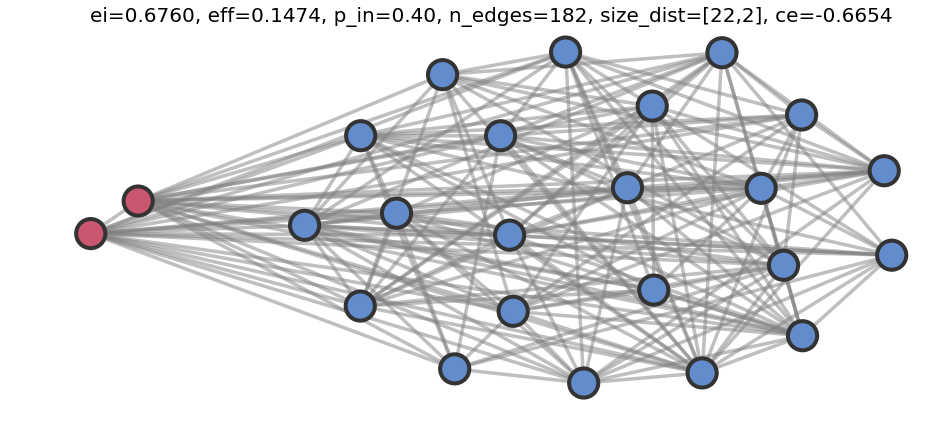

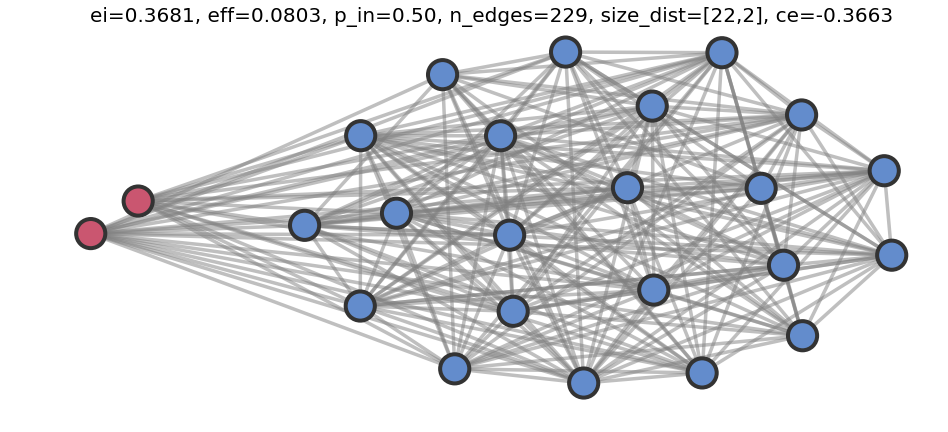

...

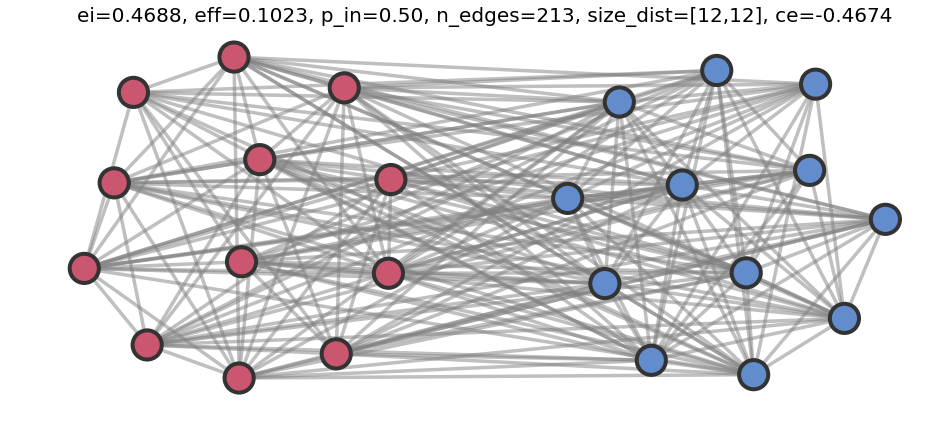

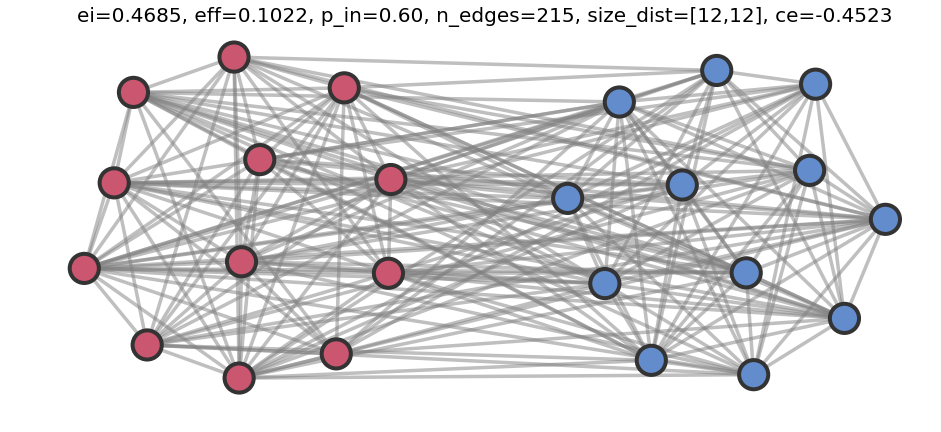

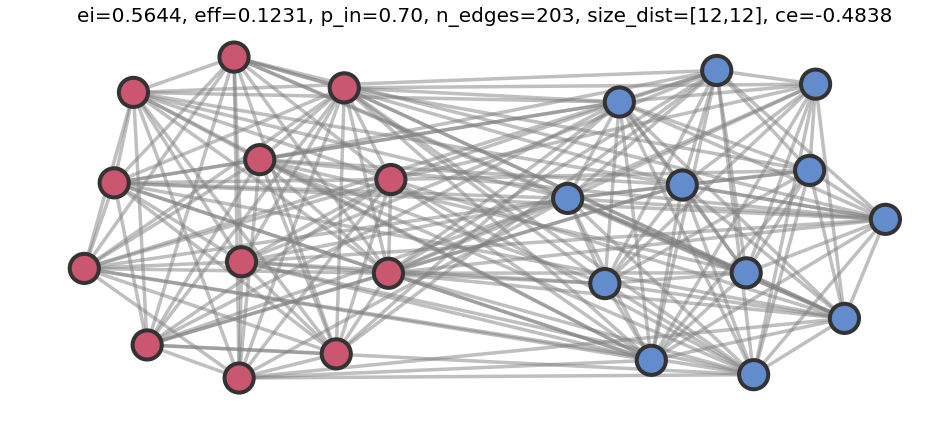

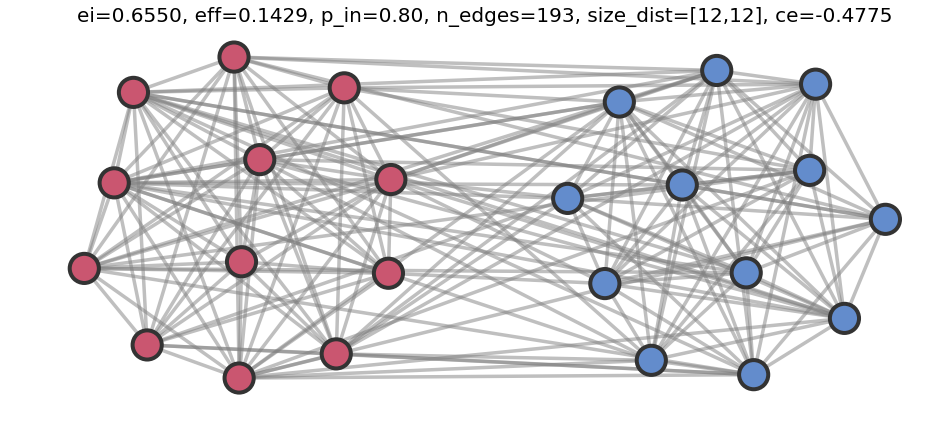

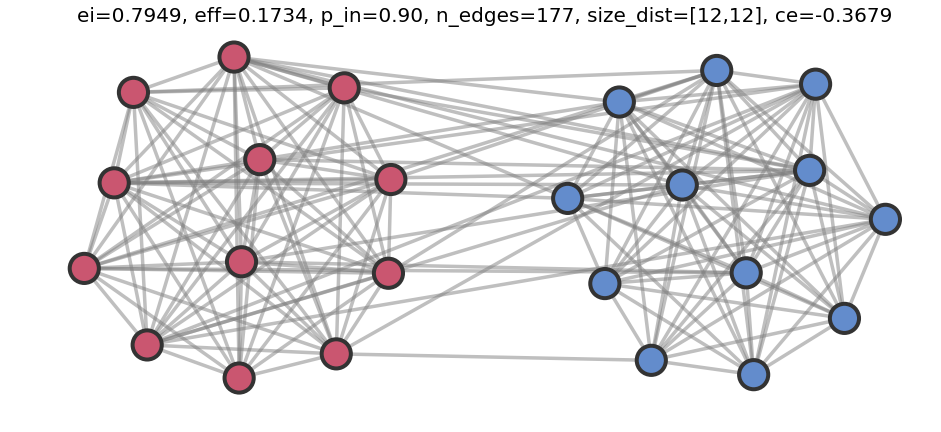

In [16]:
colors = ["#638ccc","#ca5670","#c57c3c","#ab62c0","#72a555"]
n_times = 1
N = 24
# ranges = np.arange(2, N+1, 1, dtype=int)
ranges = np.arange(2, int(N/2)+1, 1, dtype=int)

out_ei = []
out_pi = []
out_ss = []
out_ce = []
out_sd = []
pin_probs = np.linspace(0,1,len(ranges))

for i in ranges:
#     print("Starting iteration %02i at %s"%(i, dt.datetime.now()))
    sizes = [N-i, i]
    macros = [0]*sizes[0] + [1]*sizes[1]
    pos = get_pos(N, sizes)
    for p_in in pin_probs:
        out_ei_i = []
        out_pi_i = []
        out_ss_i = []
        out_ce_i = []
        p_ex = 1-p_in
        
        for nn in range(n_times):
            G = nx.Graph()
            G.add_nodes_from(list(range(sum(sizes))))
            nx.set_node_attributes(G, dict(zip(G.nodes(),list(np.array(macros)+N))), 'macro')
            
            probs = [p_in]*sizes[0] + [p_ex]*sizes[1]
            for node_i in list(G.nodes())[:sizes[0]]:
                for node_j in list(G.nodes()):#[:sizes[0]]:
                    if np.random.rand() < probs[node_j]:
                        G.add_edge(node_i, node_j)
                        G.add_edge(node_j, node_i)
            probs = [p_ex]*sizes[0] + [p_in]*sizes[1]
            for node_i in list(G.nodes())[sizes[0]:]:
                for node_j in list(G.nodes()):#[sizes[0]:]:
                    if np.random.rand() < probs[node_j]:
                        G.add_edge(node_i, node_j)
                        G.add_edge(node_j, node_i)
            
            G = nx.Graph(nx.DiGraph(G))
            current_ei = get_ei(G, p0=0)
            
            nodecols = [colors[i-N] for i in nx.get_node_attributes(G,'macro').values()]

            mac_map = nx.get_node_attributes(G, 'macro')
            mG = get_macro(G, mac_map, p0=0)
            macro_ei = get_ei(mG, p0=0)

            out_ce_i.append(current_ei-macro_ei)
            out_ei_i.append(current_ei)
            out_ss_i.append(sizes[0]/N)
            out_pi_i.append(p_in)
            
            if current_ei-macro_ei > 0:# == 12:#np.random.rand() < 1.0:
#             if np.random.rand() < 0.02:
                plt.figure(figsize=(16,7))
                nx.draw_networkx_nodes(G, pos, node_size=850, 
                                       linewidths=4.0, node_color=nodecols).set_edgecolor('#333333')
                nx.draw_networkx_edges(G, pos, edge_color='grey', width=3.5, alpha=0.5)
                plt.title("ei=%.4f, eff=%.4f, p_in=%.2f, n_edges=%i, size_dist=[%i,%i], ce=%.4f"%
                          (get_ei(G, p0=0),get_ei(G, p0=0)/np.log2(N), p_in, 
                           G.number_of_edges(), sizes[0], sizes[1], -out_ce_i[-1]),size=20)
                plt.axis('off')
                plt.show()            

        out_ce.append(np.mean(out_ce_i))
        out_ei.append(np.mean(out_ei_i))
        out_ss.append(np.mean(out_ss_i))
        out_pi.append(np.mean(out_pi_i))
        out_sd.append(np.std(out_ce_i))

out_dict = {'p_in':          out_pi, 
            'size_leftchunk':out_ss, 
            'ei':            out_ei, 
            'ce':            out_ce,
            'sdce':          out_sd}

In [20]:
get_ei(G, p0=0)

1.0

In [15]:
1+1

2

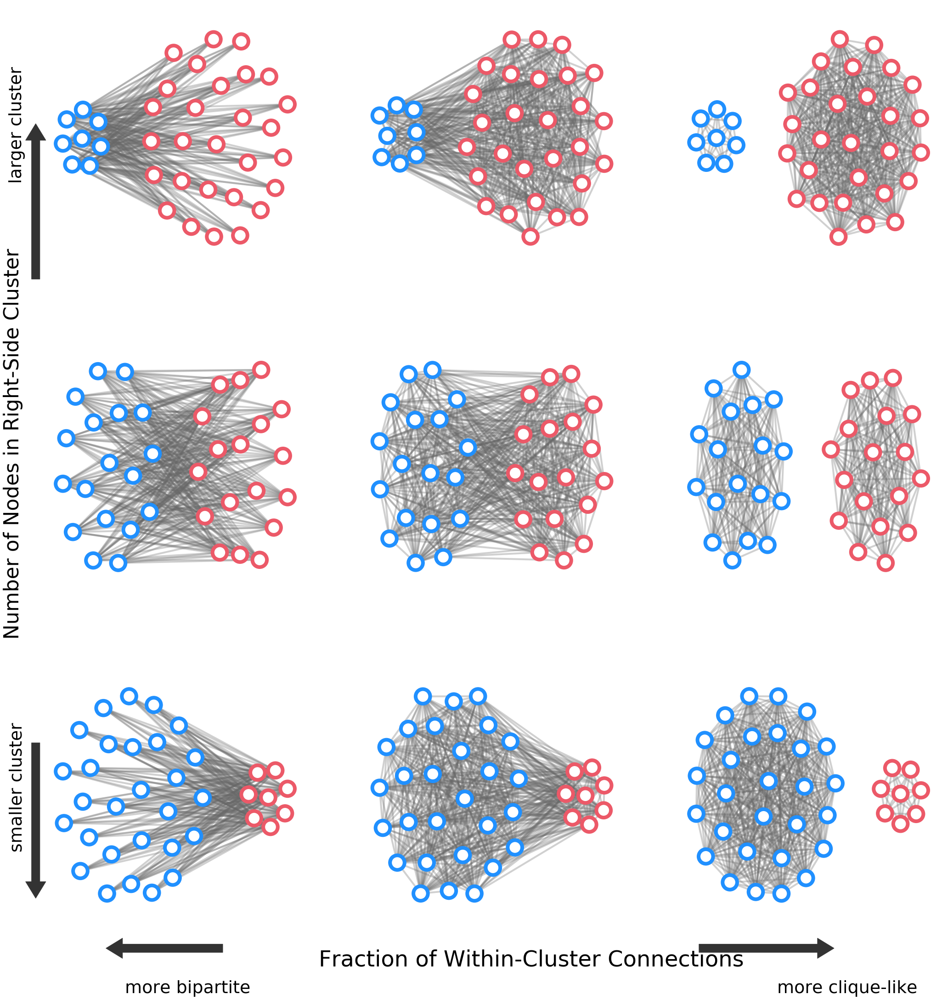

In [13]:
colors = ["#ec5968","#2090ff","#ca5670","#f7aa50","#638ccc","#59b9c3",
          "#9d53d6","#50e1b5","#ca5670","#c57c3c","#ab62c0","#72a555"]
n_times = 1
N = 36
sm = 8
ranges = np.array([sm, int(N/2), N-sm])
pin_probs = np.linspace(0,1,3)

fig, ((ax00,ax01,ax02),(ax10,ax11,ax12),(ax20,ax21,ax22)) = plt.subplots(3,3,figsize=(31,30))
# fig, ((ax00,ax01,ax02),(ax10,ax11,ax12),(ax20,ax21,ax22)) = plt.subplots(3,3,figsize=(40,28))
axx = [(ax00,ax01,ax02),(ax10,ax11,ax12),(ax20,ax21,ax22)]
for ii in range(len(ranges)):
    i = ranges[ii]
    sizes = [N-i, i]
    macros = [0]*sizes[0] + [1]*sizes[1]

    for pp in range(len(pin_probs)):
        p_in = pin_probs[pp]
        out_ei_i = []
        out_pi_i = []
        out_ss_i = []
        out_ce_i = []
        p_ex = 1-p_in
        
        G = nx.Graph()
        G.add_nodes_from(list(range(sum(sizes))))
        nx.set_node_attributes(G, dict(zip(G.nodes(),macros)), 'macro')

        probs = [p_in]*sizes[0] + [p_ex]*sizes[1]
        for node_i in list(G.nodes())[:sizes[0]]:
            for node_j in list(G.nodes()):#[:sizes[0]]:
                if np.random.rand() < probs[node_j]:
                    G.add_edge(node_i, node_j)
                    G.add_edge(node_j, node_i)
        probs = [p_ex]*sizes[0] + [p_in]*sizes[1]
        for node_i in list(G.nodes())[sizes[0]:]:
            for node_j in list(G.nodes()):#[sizes[0]:]:
                if np.random.rand() < probs[node_j]:
                    G.add_edge(node_i, node_j)
                    G.add_edge(node_j, node_i)

        G = nx.Graph(nx.DiGraph(G))
        current_ei = get_ei(G, p0=0)
        ns = 1000
        if ii!=2:
            nodecols = [colors[i] for i in nx.get_node_attributes(G,'macro').values()]
            pos = get_pos(N, sizes)
            nx.draw_networkx_nodes(G, pos, node_size=ns, linewidths=8.0, ax=axx[ii][pp],
                                   node_color='w').set_edgecolor(nodecols)
#                                    node_color=nodecols).set_edgecolor('#333333')
#             nx.draw_networkx_edges(G, pos, edge_color='#333333', width=4.0, alpha=0.4, ax=axx[ii][pp])
            nx.draw_networkx_edges(G, pos, edge_color='#666666', width=4.0, alpha=0.3, ax=axx[ii][pp])
            axx[ii][pp].set_axis_off()

        else:
            nodecols = [colors[i] for i in nx.get_node_attributes(G,'macro').values()]
            pos = dict(zip(G.nodes(), -1*np.array(list(get_pos(N, sizes).values()))))
            nx.draw_networkx_nodes(G, pos, node_size=ns, linewidths=8.0, ax=axx[ii][pp],
                                   node_color='w').set_edgecolor(nodecols)
#                                    node_color=nodecols).set_edgecolor('#333333')
#             nx.draw_networkx_edges(G, pos, edge_color='#333333', width=4.0, alpha=0.4, ax=axx[ii][pp])
            nx.draw_networkx_edges(G, pos, edge_color='#666666', width=4.0, alpha=0.3, ax=axx[ii][pp])
            axx[ii][pp].set_axis_off()
            
ax21.text(-2.95, -1.295, 'Fraction of Within-Cluster Connections', fontsize=48)
ax21.text( 2.11, -1.500, 'more clique-like', fontsize=38)
ax21.text(-5.09, -1.500, 'more bipartite', fontsize=38)

ax10.text(-1.15,  1.045, 'Number of Nodes in Right-Side Cluster', fontsize=44, rotation=90)
ax10.text(-1.09, -1.380, 'smaller cluster', fontsize=38, rotation=90)
ax10.text(-1.09,  1.995, 'larger cluster', fontsize=38, rotation=90)

plt.axes([0.1, 0.02, 0.89, 0.99])
plt.axis('off')
style="Simple,head_length=36,head_width=44,tail_width=18"
arrow11 = arrow11 = mpatches.FancyArrowPatch((0.74,0.04), (0.89,0.04), 
                                             arrowstyle=style, color="#333333")
plt.gca().add_patch(arrow11)
arrow12 = arrow11 = mpatches.FancyArrowPatch((0.22,0.04), (0.09,0.04), 
                                             arrowstyle=style, color="#333333")
plt.gca().add_patch(arrow12)

style="Simple,head_length=36,head_width=44,tail_width=18"
arrow11 = arrow11 = mpatches.FancyArrowPatch((0.014,0.72), (0.014,0.88), 
                                             arrowstyle=style, color="#333333")
plt.gca().add_patch(arrow11)
arrow12 = arrow11 = mpatches.FancyArrowPatch((0.014,0.25), (0.014,0.09), 
                                             arrowstyle=style, color="#333333")
plt.gca().add_patch(arrow12)

plt.subplots_adjust(left=0.125, bottom=0.1, right=0.99, top=0.99, wspace=0.25, hspace=0.45)
# plt.savefig("../figs/pngs/NetworkViz_CliquesToBipartite_VaryingSizes_mean_sd_N32.png", dpi=425, bbox_inches='tight')
# plt.savefig("../figs/pdfs/NetworkViz_CliquesToBipartite_VaryingSizes_mean_sd_N32.pdf", bbox_inches='tight')
plt.show()

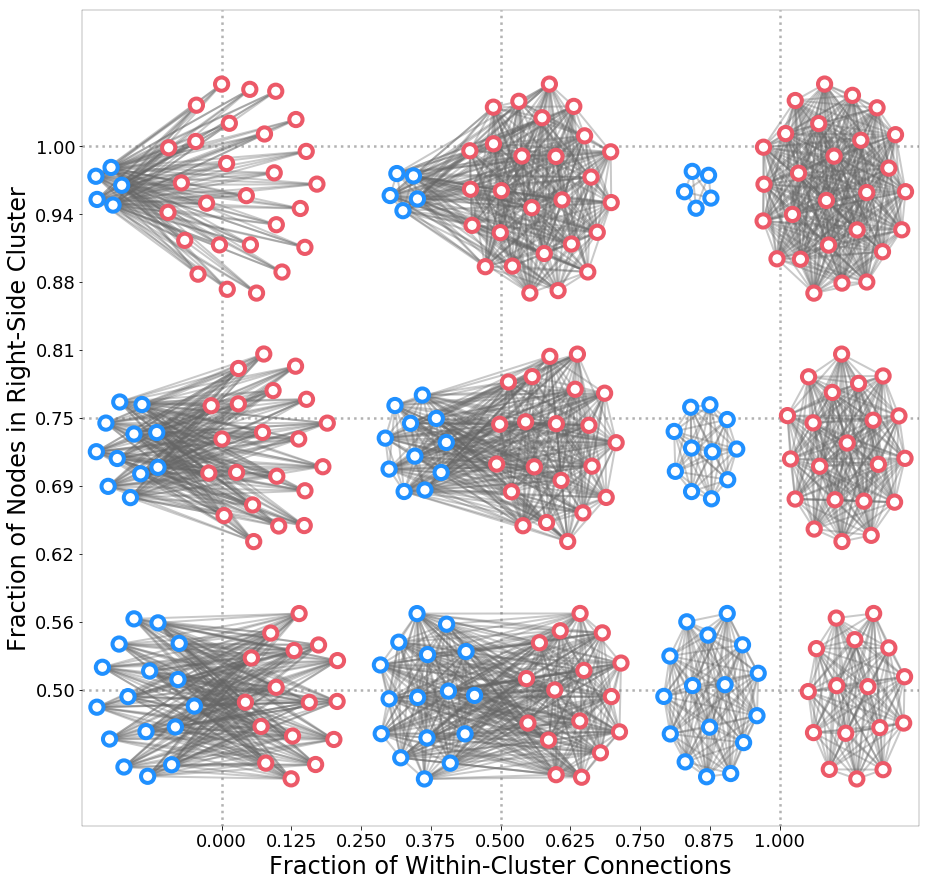

In [27]:
n_times = 1
colors = ["#ec5968","#2090ff","#f7aa50","#ca5670","#72a555","#2090ff","#638ccc","#59b9c3","#ec5968",
          "#9d53d6","#50e1b5","#ca5670","#c57c3c","#ab62c0"]

plt.rcParams['axes.linewidth'] = 0.25
N = 32
sm = int(N/2)
ranges    = np.arange(2, int(N/2)+1, 2, dtype=int)
pin_probs = np.linspace(0, 1, len(ranges)+1)

imsho_ce = np.array([0]*len(ranges)**2).reshape((len(ranges),len(ranges))).T
xtix = pin_probs
ytix = (N-ranges)/N
xlab = "Fraction of Within-Cluster Connections"
ylab = "Fraction of Nodes in Right-Side Cluster"
tit0 = "Stochastic Block Models and Causal Emergence\n N = %i, n_iter = %i"%(N,n_times)

fig, ax0 = plt.subplots(1, 1, figsize=(15,15))
# im_ce = ax0.imshow(imsho_ce, cmap=plt.cm.Greys, vmin=minval_ce, vmax=maxval_ce, aspect='auto')

axx = [[0.1250, 0.155, 0.25, 0.18], [0.3875, 0.155, 0.25, 0.18], [0.6500, 0.155, 0.25, 0.18],
       [0.1250, 0.375, 0.24, 0.20], [0.3925, 0.375, 0.24, 0.20], [0.6600, 0.375, 0.24, 0.20], 
       [0.1250, 0.605, 0.23, 0.22], [0.3975, 0.605, 0.23, 0.22], [0.6700, 0.605, 0.23, 0.22]]

ranges = np.linspace(sm, N-5, 3, dtype=int)
rlist = [0,1,2,0,1,2,0,1,2]
pin_probs = np.linspace(0.5,1,3)
dat = {'p_in': [0.0, 0.5, 1.0, 0.0, 0.5, 1.0, 0.0, 0.5, 1.0], 
      'sizes': [ranges[0], ranges[0], ranges[0], ranges[1], ranges[1], ranges[1], ranges[2], ranges[2], ranges[2]]}

for ii in range(len(axx)):
    aa = axx[ii]
    plt.axes(aa)
    
    i      = dat['sizes'][ii]
    sizes  = [i, N-i]
    macros = [0]*sizes[0] + [1]*sizes[1]
    p_in   = dat['p_in'][ii]
    p_ex   = 1-p_in

    G = nx.Graph()
    G.add_nodes_from(list(range(sum(sizes))))
    nx.set_node_attributes(G, dict(zip(G.nodes(),macros)), 'macro')

    probs = [p_in]*sizes[0] + [p_ex]*sizes[1]
    for node_i in list(G.nodes())[:sizes[0]]:
        for node_j in list(G.nodes()):#[:sizes[0]]:
            if np.random.rand() < probs[node_j]:
                G.add_edge(node_i, node_j)
                G.add_edge(node_j, node_i)

    probs = [p_ex]*sizes[0] + [p_in]*sizes[1]
    for node_i in list(G.nodes())[sizes[0]:]:
        for node_j in list(G.nodes()):#[sizes[0]:]:
            if np.random.rand() < probs[node_j]:
                G.add_edge(node_i, node_j)
                G.add_edge(node_j, node_i)

    G = nx.Graph(nx.DiGraph(G))
    ns = 175
    nodecols = [colors[i] for i in nx.get_node_attributes(G,'macro').values()]
    pos = get_pos(N, sizes)
    nx.draw_networkx_nodes(G, pos, node_size=ns, linewidths=4.0, node_color='w').set_edgecolor(nodecols)
    nx.draw_networkx_edges(G, pos, edge_color='#666666', width=2.0, alpha=0.35)

    plt.axis('off')
################################
# subplot labeling
ax0.set_xlabel(xlab, size=24)
ax0.set_ylabel(ylab, size=24)
ax0.set_xticks(np.array(list(range(len(xtix)))))
ax0.set_yticks(np.array(list(range(len(ytix)+1))))
ax0.set_xticklabels(["%.3f"%i for i in xtix], size=18)
ax0.set_yticklabels(["%.2f"%i for i in np.linspace(1,0.5,9)], size=18)
ax0.set_xticks(np.array([0,4,8]), minor=True)
ax0.set_yticks(np.array([0,4,8]), minor=True)
ax0.grid(which='minor', linestyle=':', color='#666666', linewidth=2.5, alpha=0.5)

ax0.set_xlim(-2, 10)
ax0.set_ylim(10, -2)
# plt.savefig("../figs/pngs/NetworkViz_CliquesToBipartite_VaryingSizes_N32.png", dpi=425, bbox_inches='tight')
# plt.savefig("../figs/pdfs/NetworkViz_CliquesToBipartite_VaryingSizes_N32.pdf", bbox_inches='tight')
plt.show()

In [21]:
np.linspace(1,0.5,9)

array([1.    , 0.9375, 0.875 , 0.8125, 0.75  , 0.6875, 0.625 , 0.5625,
       0.5   ])

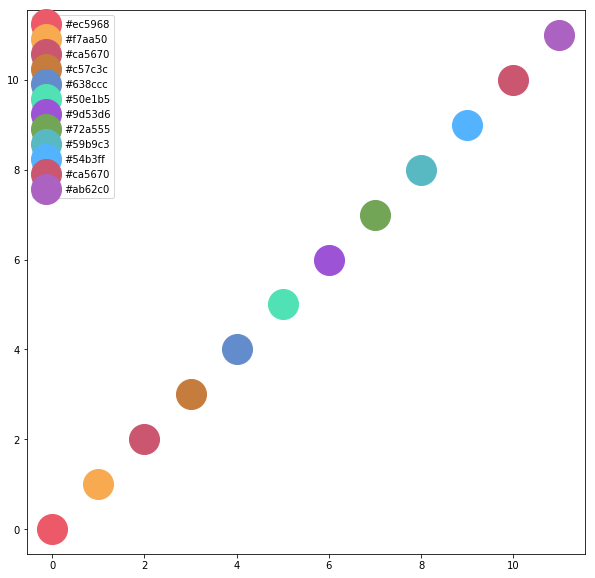

In [29]:
plt.figure(figsize=(10,10))
colors = ["#ec5968","#50e1b5","#ca5670","#f7aa50","#54b3ff","#59b9c3",
          "#9d53d6","#638ccc","#ca5670","#c57c3c","#ab62c0","#72a555"]
np.random.shuffle(colors)
for i in range(len(colors)):
    plt.plot([i], [i], color=colors[i], marker='o', markersize=30, label=colors[i])
    
plt.legend()
plt.show()

In [210]:
xx = np.random.uniform(-1,1,size=(9,9))

In [211]:
xx<0

array([[ True,  True, False, False, False,  True,  True,  True,  True],
       [False,  True,  True,  True, False,  True, False,  True, False],
       [False, False, False,  True,  True,  True,  True, False, False],
       [ True,  True,  True, False,  True, False, False, False,  True],
       [False, False, False,  True,  True, False, False,  True, False],
       [ True,  True,  True,  True,  True,  True, False, False,  True],
       [ True, False,  True, False, False,  True, False,  True, False],
       [False,  True,  True, False, False,  True, False,  True, False],
       [ True, False,  True,  True,  True,  True, False, False, False]])

In [ ]:
df = pd.DataFrame(out_dict)
fig, ax = plt.subplots(1, 1, figsize=(14,14))
maxval = max(out_dict['ce'])
minval = min(out_dict['ce'])
if np.abs(minval) > np.abs(maxval):
    maxval = np.abs(minval)
else:
    minval = -maxval

x = out_dict['p_in']
y = out_dict['size_leftchunk']
eis = np.array(out_dict['ei'])
ces = np.array(out_dict['ce'])
newshape = (len(np.unique(out_dict['p_in'])), len(np.unique(out_dict['size_leftchunk'])))

imsho = df.set_index(['p_in', 'size_leftchunk']).ce.unstack(0)
im = ax.imshow(imsho, cmap=plt.cm.RdBu, vmin=minval, vmax=maxval, aspect='auto')

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.15)
cb = plt.colorbar(im, cax=cax)
cb.set_label("Micro EI - Macro EI", fontsize=24, rotation=270, labelpad=20.0)
cb.ax.tick_params(labelsize=14) 

ax.set_xlabel("Fraction of in-cluster connections", size=22)
ax.set_ylabel("Fraction of the total network (left chunk's size)", size=22)

xtix = pin_probs
ytix = (N-ranges)/N
ax.set_xticks(np.array(list(range(len(xtix)))))
ax.set_yticks(np.array(list(range(len(ytix)))))
ax.set_xticklabels(["%.2f"%i for i in xtix], size=12)
ax.set_yticklabels(["%.2f"%i for i in ytix], size=12)

ax.set_xticks(np.array(list(range(len(xtix))))-0.5, minor=True)
ax.set_yticks(np.array(list(range(len(ytix))))-0.5, minor=True)
ax.grid(which='minor', linestyle='-', color='gainsboro', linewidth=2.0, alpha=0.8)

# plt.savefig("../figs/pngs/CausalEmergence_CliquesToBipartite_VaryingSizes_N40.png", dpi=425, bbox_inches='tight')
# plt.savefig("../figs/pdfs/CausalEmergence_CliquesToBipartite_VaryingSizes_N40.pdf", bbox_inches='tight')
# plt.savefig("../figs/pngs/CausalEmergence_CliquesToBipartite_VaryingSizes_N24.png", dpi=425, bbox_inches='tight')
# plt.savefig("../figs/pdfs/CausalEmergence_CliquesToBipartite_VaryingSizes_N24.pdf", bbox_inches='tight')
plt.show()

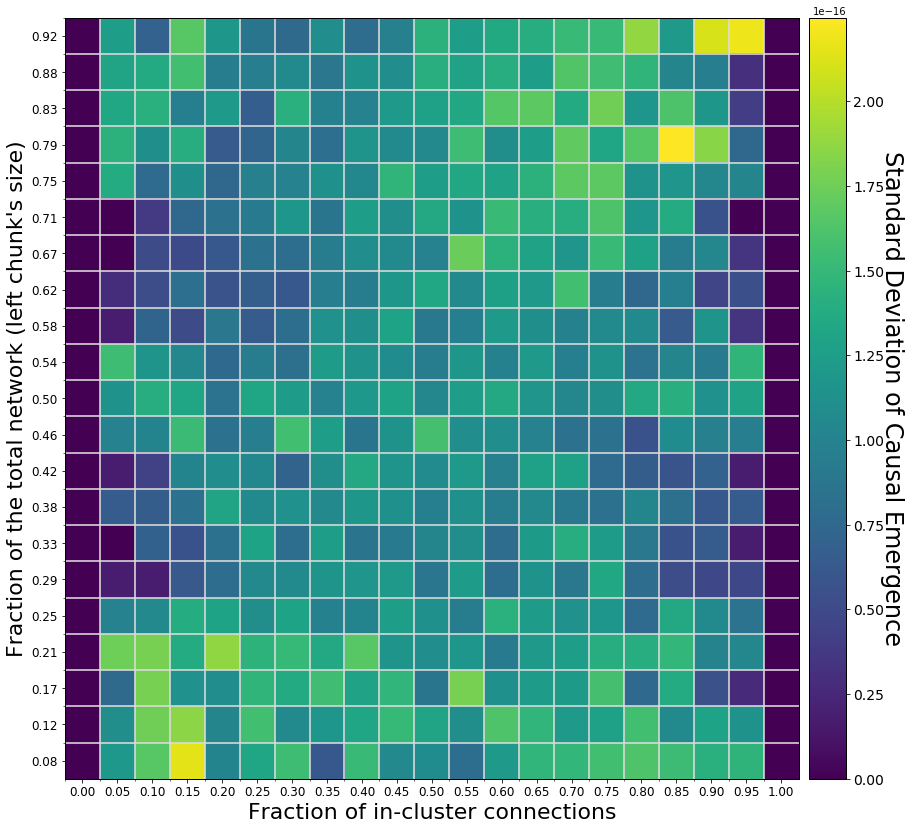

In [312]:
df = pd.DataFrame(out_dict)

plt.rcParams['axes.linewidth'] = 1.0
fig, ax = plt.subplots(1, 1, figsize=(14,14))
maxval = max(out_dict['sdce'])
minval = min(out_dict['sdce'])
# if np.abs(minval) > np.abs(maxval):
#     maxval = np.abs(minval)
# else:
#     minval = -maxval

x = out_dict['p_in']
y = out_dict['size_leftchunk']
eis = np.array(out_dict['ei'])
ces = np.array(out_dict['ce'])
newshape = (len(np.unique(out_dict['p_in'])), len(np.unique(out_dict['size_leftchunk'])))

imsho = df.set_index(['p_in', 'size_leftchunk']).sdce.unstack(0)
im = ax.imshow(imsho, cmap=plt.cm.viridis, vmin=minval, vmax=maxval, aspect='auto')

divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.15)
cb = plt.colorbar(im, cax=cax)
cb.set_label("Standard Deviation of Causal Emergence", fontsize=24, rotation=270, labelpad=20.0)
cb.ax.tick_params(labelsize=14) 

ax.set_xlabel("Fraction of in-cluster connections", size=22)
ax.set_ylabel("Fraction of the total network (left chunk's size)", size=22)

xtix = pin_probs
ytix = (N-ranges)/N
ax.set_xticks(np.array(list(range(len(xtix)))))
ax.set_yticks(np.array(list(range(len(ytix)))))
ax.set_xticklabels(["%.2f"%i for i in xtix], size=12)
ax.set_yticklabels(["%.2f"%i for i in ytix], size=12)

ax.set_xticks(np.array(list(range(len(xtix))))-0.5, minor=True)
ax.set_yticks(np.array(list(range(len(ytix))))-0.5, minor=True)
ax.grid(which='minor', linestyle='-', color='gainsboro', linewidth=2.0, alpha=0.8)

# plt.savefig("../figs/pngs/CausalEmergence_CliquesToBipartite_VaryingSizes_sd_N24.png", dpi=425, bbox_inches='tight')
# plt.savefig("../figs/pdfs/CausalEmergence_CliquesToBipartite_VaryingSizes_sd_N24.pdf", bbox_inches='tight')
plt.show()

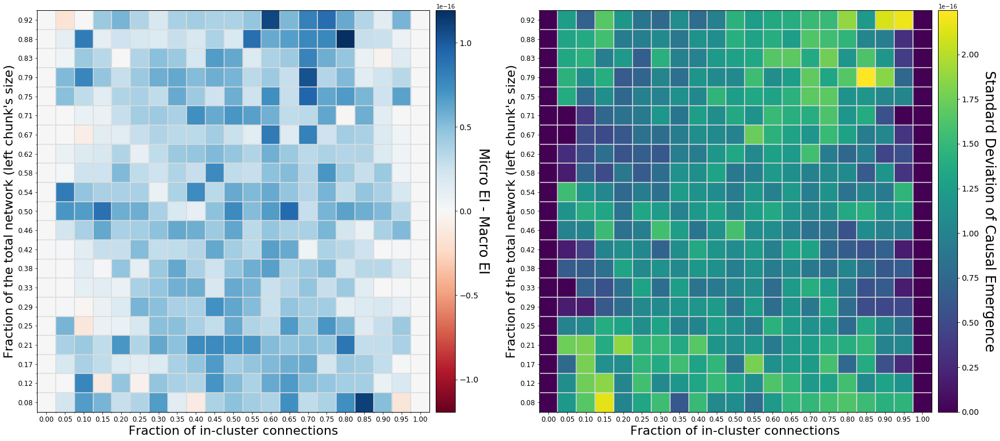

In [325]:
df = pd.DataFrame(out_dict)

fig, (ax0,ax1) = plt.subplots(1, 2, figsize=(29,13))

maxval = max(out_dict['ce'])
minval = min(out_dict['ce'])
if np.abs(minval) > np.abs(maxval):
    maxval = np.abs(minval)
else:
    minval = -maxval

imsho_ce = df.set_index(['p_in', 'size_leftchunk']).ce.unstack(0)
im_ce = ax0.imshow(imsho_ce, cmap=plt.cm.RdBu, vmin=minval, vmax=maxval, aspect='auto')

divider = make_axes_locatable(ax0)
cax = divider.append_axes("right", size="5%", pad=0.15)
cb = plt.colorbar(im_ce, cax=cax)
cb.set_label("Micro EI - Macro EI", fontsize=24, rotation=270, labelpad=20.0)
cb.ax.tick_params(labelsize=14) 

ax0.set_xlabel("Fraction of in-cluster connections", size=22)
ax0.set_ylabel("Fraction of the total network (left chunk's size)", size=22)

xtix = pin_probs
ytix = (N-ranges)/N
ax0.set_xticks(np.array(list(range(len(xtix)))))
ax0.set_yticks(np.array(list(range(len(ytix)))))
ax0.set_xticklabels(["%.2f"%i for i in xtix], size=12)
ax0.set_yticklabels(["%.2f"%i for i in ytix], size=12)

ax0.set_xticks(np.array(list(range(len(xtix))))-0.5, minor=True)
ax0.set_yticks(np.array(list(range(len(ytix))))-0.5, minor=True)
ax0.grid(which='minor', linestyle='-', color='gainsboro', linewidth=2.0, alpha=0.8)

#########

maxval = max(out_dict['sdce'])
minval = min(out_dict['sdce'])

imsho_sd = df.set_index(['p_in', 'size_leftchunk']).sdce.unstack(0)
im_sd = ax1.imshow(imsho_sd, cmap=plt.cm.viridis, vmin=minval, vmax=maxval, aspect='auto')

divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.15)
cb = plt.colorbar(im_sd, cax=cax)
cb.set_label("Standard Deviation of Causal Emergence", fontsize=24, rotation=270, labelpad=30.0)
cb.ax.tick_params(labelsize=14) 

ax1.set_xlabel("Fraction of in-cluster connections", size=22)
ax1.set_ylabel("Fraction of the total network (left chunk's size)", size=22)

xtix = pin_probs
ytix = (N-ranges)/N
ax1.set_xticks(np.array(list(range(len(xtix)))))
ax1.set_yticks(np.array(list(range(len(ytix)))))
ax1.set_xticklabels(["%.2f"%i for i in xtix], size=12)
ax1.set_yticklabels(["%.2f"%i for i in ytix], size=12)

ax1.set_xticks(np.array(list(range(len(xtix))))-0.5, minor=True)
ax1.set_yticks(np.array(list(range(len(ytix))))-0.5, minor=True)
ax1.grid(which='minor', linestyle='-', color='gainsboro', linewidth=2.0, alpha=0.8)

# plt.savefig("../figs/pngs/CausalEmergence_CliquesToBipartite_VaryingSizes_mean_sd_N24.png", dpi=425, bbox_inches='tight')
# plt.savefig("../figs/pdfs/CausalEmergence_CliquesToBipartite_VaryingSizes_mean_sd_N24.pdf", bbox_inches='tight')
plt.show()

In [ ]:
n_times = 32
N = 64
ranges = np.arange(2, N-1, 1, dtype=int)

out_ei = []
out_pi = []
out_ss = []
out_ce = []
out_sd = []
pin_probs = np.linspace(0,1,len(ranges))

for i in ranges:
    print("Starting iteration %02i at %s"%(i, dt.datetime.now()))
    sizes = [N-i, i]
    macros = [0]*sizes[0] + [1]*sizes[1]
    for p_in in pin_probs:
        out_ei_i = []
        out_pi_i = []
        out_ss_i = []
        out_ce_i = []
        p_ex = 1-p_in
        
        for nn in range(n_times):
            G = nx.Graph()
            G.add_nodes_from(list(range(sum(sizes))))
            nx.set_node_attributes(G, macros, 'macro')
            
            probs = [p_in]*sizes[0] + [p_ex]*sizes[1]
            for node_i in list(G.nodes())[:sizes[0]]:
                for node_j in list(G.nodes()):#[:sizes[0]]:
                    if np.random.rand() < probs[node_j]:
                        G.add_edge(node_i, node_j)
                        G.add_edge(node_j, node_i)
            probs = [p_ex]*sizes[0] + [p_in]*sizes[1]
            for node_i in list(G.nodes())[sizes[0]:]:
                for node_j in list(G.nodes()):#[sizes[0]:]:
                    if np.random.rand() < probs[node_j]:
                        G.add_edge(node_i, node_j)
                        G.add_edge(node_j, node_i)

            current_ei = get_ei(G, p0=0)

            mac_map = nx.get_node_attributes(G, 'macro')
            mG = get_macro(G, mac_map, p0=0)
            macro_ei = get_ei(mG, p0=0)

            out_ce_i.append(current_ei-macro_ei)
            out_ei_i.append(current_ei)
            out_ss_i.append(sizes[0]/N)
            out_pi_i.append(p_in)

        out_ce.append(np.mean(out_ce_i))
        out_ei.append(np.mean(out_ei_i))
        out_ss.append(np.mean(out_ss_i))
        out_pi.append(np.mean(out_pi_i))
        out_sd.append(np.std(out_ce_i))

out_dict = {'p_in':          out_pi, 
            'size_leftchunk':out_ss, 
            'ei':            out_ei, 
            'ce':            out_ce,
            'sdce':          out_sd}

Starting iteration 02 at 2018-11-27 17:30:34.044121
Starting iteration 03 at 2018-11-27 17:32:44.143850
Starting iteration 04 at 2018-11-27 17:34:50.820156


In [ ]:
df = pd.DataFrame(out_dict)

fig, (ax0,ax1) = plt.subplots(1, 2, figsize=(29,13))

maxval = max(out_dict['ce'])*0.75
minval = min(out_dict['ce'])*0.75
if np.abs(minval) > np.abs(maxval):
    maxval = np.abs(minval)
else:
    minval = -maxval

imsho_ce = df.set_index(['p_in', 'size_leftchunk']).ce.unstack(0)
im_ce = ax0.imshow(imsho_ce, cmap=plt.cm.RdBu, vmin=minval, vmax=maxval, aspect='auto')

divider = make_axes_locatable(ax0)
cax = divider.append_axes("right", size="5%", pad=0.15)
cb = plt.colorbar(im_ce, cax=cax)
cb.set_label("Average Micro EI - Average Macro EI", fontsize=24, rotation=270, labelpad=26.0)
cb.ax.tick_params(labelsize=14) 

ax0.set_xlabel("Fraction of in-cluster connections", size=22)
ax0.set_ylabel("Fraction of the total network (left chunk's size)", size=22)

xtix = pin_probs
ytix = (N-ranges)/N
ax0.set_xticks(np.array(list(range(len(xtix)))))
ax0.set_yticks(np.array(list(range(len(ytix)))))
ax0.set_xticklabels(["%.2f"%i for i in xtix], size=10)
ax0.set_yticklabels(["%.2f"%i for i in ytix], size=10)

ax0.set_xticks(np.array(list(range(len(xtix))))-0.5, minor=True)
ax0.set_yticks(np.array(list(range(len(ytix))))-0.5, minor=True)
ax0.grid(which='minor', linestyle='-', color='gainsboro', linewidth=2.0, alpha=0.8)

#########

maxval = max(out_dict['sdce'])
minval = min(out_dict['sdce'])

imsho_sd = df.set_index(['p_in', 'size_leftchunk']).sdce.unstack(0)
im_sd = ax1.imshow(imsho_sd, cmap=plt.cm.viridis, vmin=minval, vmax=maxval, aspect='auto')

divider = make_axes_locatable(ax1)
cax = divider.append_axes("right", size="5%", pad=0.15)
cb = plt.colorbar(im_sd, cax=cax)
cb.set_label("Standard Deviation of Micro EI - Macro EI", fontsize=24, rotation=270, labelpad=30.0)
cb.ax.tick_params(labelsize=14) 

ax1.set_xlabel("Fraction of in-cluster connections", size=22)
ax1.set_ylabel("Fraction of the total network (left chunk's size)", size=22)

xtix = pin_probs
ytix = (N-ranges)/N
ax1.set_xticks(np.array(list(range(len(xtix)))))
ax1.set_yticks(np.array(list(range(len(ytix)))))
ax1.set_xticklabels(["%.2f"%i for i in xtix], size=10)
ax1.set_yticklabels(["%.2f"%i for i in ytix], size=10)

ax1.set_xticks(np.array(list(range(len(xtix))))-0.5, minor=True)
ax1.set_yticks(np.array(list(range(len(ytix))))-0.5, minor=True)
ax1.grid(which='minor', linestyle='-', color='gainsboro', linewidth=2.0, alpha=0.8)

ax0.text(10.0, -1.4, "Means and Standard Deviations of Causal Emergence: N = %i, n_iter = %i"%(N,n_times), fontsize=28)

plt.savefig("../figs/pngs/CausalEmergence_CliquesToBipartite_VaryingSizes_mean_sd_N32.png", dpi=425, bbox_inches='tight')
plt.savefig("../figs/pdfs/CausalEmergence_CliquesToBipartite_VaryingSizes_mean_sd_N32.pdf", bbox_inches='tight')
plt.show()

In [ ]:
nmax = 100
n_con = 1
chunksizes = np.linspace(2,nmax,50,dtype=int)
macro_eis = []
micro_eis = []

for n in chunksizes:
    G = unbalanced_barbell(nmax,n,n_con,p0)
    micro_eis.append(get_ei(G, p0))

    if n==20:
        Gout = G.copy()
    micro_nodes_left = list(G.nodes())
    macro_mapping = dict(zip(micro_nodes_left, micro_nodes_left))
    leftout = len(micro_nodes_left)-nmax

    for i in range(nmax):
        macro_mapping[i] = G.number_of_nodes()

    for i in range(leftout):
        macro_mapping[i+nmax] = G.number_of_nodes()+1

    MACRO = get_macro(G, macro_mapping, p0)
    M_ei = get_ei(MACRO, p0)
    macro_eis.append(M_ei)

plt.figure(figsize=(12,9))
# plt.figure(figsize=(16,9))

plt.plot(chunksizes/nmax, [1.0]*len(chunksizes), linestyle=':', 
         linewidth=6.0, alpha=0.9, color='k', label=r'$EI$=1.0')
plt.plot(chunksizes/nmax, macro_eis, linewidth=4.0, alpha=0.8, color='dodgerblue', label='macro')
plt.plot(chunksizes/nmax, micro_eis, linewidth=4.0, alpha=0.8, color='#f9143b', label='micro')

plt.xticks(np.linspace(0, max(chunksizes)/nmax, 11), 
           np.round(np.linspace(0, max(chunksizes)/nmax, 11),2), fontsize=20)
plt.yticks(np.linspace(-1, 1, 11),
           ["","","","","", "0.0", "0.2", "0.4", "0.6", "0.8", "1.0"], fontsize=20)
plt.xlabel("Relative size of bottom clique", fontsize=22)
plt.ylabel("                               Effective information", fontsize=22)
plt.xlim(min(chunksizes)/nmax, max(chunksizes)/nmax)
plt.ylim(-1, 1.1)
plt.legend(bbox_to_anchor=(0.98,0.95), fontsize=22)
plt.grid(linewidth=2.0, color='gainsboro', linestyle='--')

micro_string = 'micro'
macro_string = 'macro'

plt.text(0.035, 0.05, micro_string, ha='left', rotation=0, wrap=False, size=21, color='#f9143b')
plt.text(0.170, 0.05, macro_string, ha='left', rotation=0, wrap=False, size=21, color='dodgerblue')
plt.text(0.405, 0.05, micro_string, ha='left', rotation=0, wrap=False, size=21, color='#f9143b')
plt.text(0.535, 0.05, macro_string, ha='left', rotation=0, wrap=False, size=21, color='dodgerblue')
plt.text(0.770, 0.05, micro_string, ha='left', rotation=0, wrap=False, size=21, color='#f9143b')
plt.text(0.895, 0.05, macro_string, ha='left', rotation=0, wrap=False, size=21, color='dodgerblue')



# plt.axes([0.70, 0.14, 0.1, 0.45])
plt.axes([0.70, 0.122, 0.1, 0.37])
G = nx.to_undirected(unbalanced_barbell(20, 20, 1, 0))
plt.axis('off')
pos23 = nx.kamada_kawai_layout(G)
nx.draw_networkx_nodes(G, pos23, node_color='white', node_size=150, 
                       linewidths=2.2, alpha=0.99).set_edgecolor('#f9143b')
nx.draw_networkx_edges(G, pos23, edge_color="#333333", width=1.5, alpha=0.8)
plt.ylim(-1.1, 1.1)
plt.xlim(-0.5, 0.5)
# plt.axes([0.81, 0.14, 0.1, 0.45])
plt.axes([0.805, 0.122, 0.1, 0.37])
G = nx.Graph()
G.add_edge(0,1)
plt.axis('off')
pos21_b = {1:np.array([0, 0.5]), 0:np.array([0, -0.5])}
nx.draw_networkx_nodes(G, pos21_b, node_color='white', node_size=[5*800, 5*800], 
                       linewidths=4, alpha=0.99).set_edgecolor('dodgerblue')
nx.draw_networkx_edges(G, pos21_b, edge_color="#333333", width=4.0, alpha=0.8)
plt.ylim(-1, 1)
plt.xlim(-0.3, 0.3)
# plt.xlim(-0.4, 0.4)


# plt.axes([0.12, 0.14, 0.1, 0.45])
plt.axes([0.12, 0.122, 0.1, 0.37])
G = nx.to_undirected(unbalanced_barbell(20, 4, 1, 0))
plt.axis('off')
pos21 = nx.kamada_kawai_layout(G)
pos21 = {k:v for k,v in pos23.items() if k < 24}
nx.draw_networkx_nodes(G, pos21, node_color='white', node_size=150, 
                       linewidths=2.2, alpha=0.99).set_edgecolor('#f9143b')
nx.draw_networkx_edges(G, pos21, edge_color="#333333", width=1.5, alpha=0.8)
plt.ylim(-1.1, 1.1)
plt.xlim(-0.5, 0.5)
# plt.axes([0.23, 0.14, 0.1, 0.45])
plt.axes([0.23, 0.122, 0.1, 0.37])
G = nx.Graph()
G.add_edge(0,1)
plt.axis('off')
pos21_b = {1:np.array([0, 0.5]), 0:np.array([0, -0.5])}
nx.draw_networkx_nodes(G, pos21_b, node_color='white', node_size=[500, 5*800], 
                       linewidths=4, alpha=0.99).set_edgecolor('dodgerblue')
nx.draw_networkx_edges(G, pos21_b, edge_color="#333333", width=4.0, alpha=0.8)
plt.ylim(-1, 1)
plt.xlim(-0.3, 0.3)
# plt.xlim(-0.4, 0.4)

# plt.axes([0.41, 0.14, 0.1, 0.45])
plt.axes([0.41, 0.122, 0.1, 0.37])
G = nx.to_undirected(unbalanced_barbell(20, 10, 1, 0))
plt.axis('off')
pos22 = nx.kamada_kawai_layout(G)
pos22 = {k:v for k,v in pos23.items() if k < 30}
nx.draw_networkx_nodes(G, pos22, node_color='white', node_size=150, 
                       linewidths=2.2, alpha=0.99).set_edgecolor('#f9143b')
nx.draw_networkx_edges(G, pos22, edge_color="#333333", width=1.5, alpha=0.8)
plt.ylim(-1.1, 1.1)
plt.xlim(-0.5, 0.5)
# plt.axes([0.52, 0.14, 0.1, 0.45])
plt.axes([0.52, 0.122, 0.1, 0.37])
G = nx.Graph()
G.add_edge(0,1)
plt.axis('off')
pos21_b = {1:np.array([0, 0.5]), 0:np.array([0, -0.5])}
nx.draw_networkx_nodes(G, pos21_b, node_color='white', node_size=[2*700, 5*800], 
                       linewidths=4, alpha=0.99).set_edgecolor('dodgerblue')
nx.draw_networkx_edges(G, pos21_b, edge_color="#333333", width=4.0, alpha=0.8)
plt.ylim(-1, 1)
plt.xlim(-0.3, 0.3)
# plt.xlim(-0.4, 0.4)

# plt.savefig("../figs/pngs/CausalEmergence_Barbell_varyingN.png", dpi=425, bbox_inches='tight')
# plt.savefig("../figs/pdfs/CausalEmergence_Barbell_varyingN.pdf", bbox_inches='tight')
plt.show()